In [1]:
import pandas as pd
import re
from datetime import date
import numpy as np
import math
import pygal
import seaborn as sns
#from plotly.offline import init_notebook_mode,iplot
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import plotly.express as px
from IPython.display import SVG, display
from plotly.subplots import make_subplots

import plotly.offline as pyo
import plotly.graph_objs as go

# Set notebook mode to work in offline
pyo.init_notebook_mode()

In [2]:
# Global Functions

sns.set_palette("pastel")
def plot_series_pie_chart(series, title, max=10, color_seq=px.colors.qualitative.Pastel1):
    series.sort_values(ascending=False, inplace=True)
    series = series[:max]
    fig = px.pie(
        names=series.index,
        values=series.values, 
        title=title,
        color_discrete_sequence=color_seq
        )
#     pio.renderers.default = 'iframe'    
    fig['data'][0].update({'textinfo' : 'label+text+value+percent'})
    fig.show(renderer="png") # or colab

def plot_bar_chart(series, title, text_position='outside', xaxis_label=None, yaxis_label=None):
    fig = go.Figure(
        data=[go.Bar(x = series.index, y = series.values, text= series.values)],
        layout_title_text=title,

    )
    fig.update_traces(texttemplate='%{text:.2s}', textposition=text_position)
    fig.update_layout(xaxis_tickangle=-45)
    if xaxis_label != None:
        fig.update_layout(xaxis_title=xaxis_label,)
    if yaxis_label != None:
        fig.update_layout(yaxis_title=yaxis_label,)

    fig.show(renderer="png") # or colab

In [3]:
df = pd.read_csv("/Users/admin/Desktop/Data Analysis and Webscrapping/Data Preprocessing and Cleaning/internshala/internshala_clean_March.csv")
df.head()

,location,domain_profile,company_name,about_the_job,who_can_apply,salary,company_details,start_date,experience,apply_by,...,WordPress,XML,Xcode,Yii,iOS,jQuery,web3.js,min_salary,max_salary,avg_salary
0,Gurgaon,Web Developer,Toolify Private Limited,Company Overview\n\nToolify Private Limited is...,1. Candidates with minimum 4 years of experience.,"8,00,000 - 12,00,000",Information above is Internshala's interpretat...,Starts Immediately,4-6 years,28 Apr' 24,...,0,0,0,0,0,0,0,800000,1200000,1000000.0
1,Indore,3d Environment Artist,Mdroid Network Private Limited,We are looking for a passionate and talented 3...,1. Candidates with minimum 1 years of experience.,"2,00,000",We are a character-driven animation studio str...,Starts Immediately,1 year,9 Mar' 24,...,0,0,0,0,0,0,0,200000,200000,200000
2,Chennai,PHP Developer,CN Solutions,Company Overview\n\nCN Solutions is a leading ...,1. Candidates with minimum 4 years of experience.,Competitive salary,Information above is Internshala's interpretat...,Starts Immediately,4-6 years,18 Mar' 24,...,0,0,0,0,0,0,0,Competitive salary,Competitive salary,Competitive salary
3,Bangalore,WordPress Developer,Webfluence,Key responsibilities: \n\n1. Design and develo...,NaN,"4,20,000 - 6,00,000","<div class=""text-container about_company_text_...",Starts Immediately,0-5 years,23 Mar' 24,...,1,0,0,0,0,0,0,420000,600000,510000.0
4,Work from home,Junior Machine Learning Specialist,"HackerPulse (San Francisco, United States)",Hackerpulse is a new and growing company. We h...,1. Candidate must be available to work from 12...,"15,000 - 35,000","<div class=""text-container about_company_text_...",Starts Immediately,0-2 years,6 Mar' 24,...,0,0,0,0,0,0,0,15000,35000,25000.0


In [4]:
fill_values = {'skills':'None', 'perks': 'None','other_requirements' :'None'}
df.fillna(fill_values, inplace=True)

In [5]:
def change_float_to_int (openings_float):
    if np.isnan(openings_float):
        return openings_float
    openings = int(float(openings_float))
    return openings

df.number_of_openings = df.number_of_openings.apply(change_float_to_int)

data_type_series = df.number_of_openings.apply(type)
print(data_type_series.value_counts())


number_of_openings
<class 'float'>    573
Name: count, dtype: int64


## Skills Analysis


In [6]:
skills_super_set = dict()
def agg_skillset(input_series):
    skills_super_set = dict()
    for input_string in input_series:
        if(type(input_string) == str):
            for i in input_string.split('\n'):
                skills_super_set[i] = skills_super_set.get(i, 0) + 1
    
    return skills_super_set


skills_super_set = agg_skillset(df['skills'])

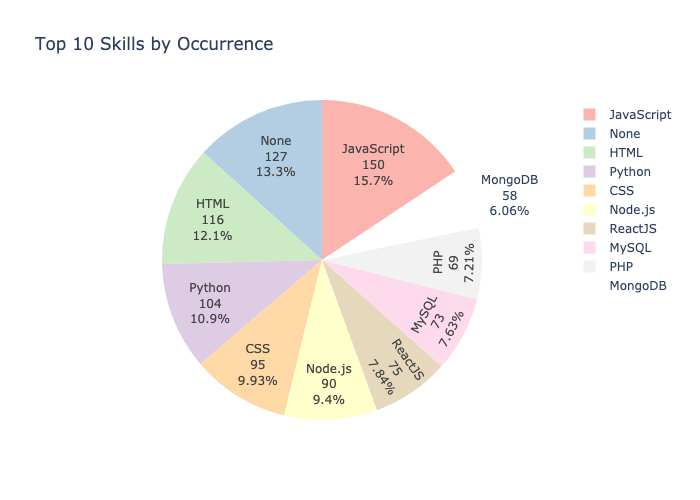

In [7]:
skills_count_series = pd.Series(skills_super_set).sort_values(ascending=False)
plot_series_pie_chart(skills_count_series, "Top 10 Skills by Occurrence")

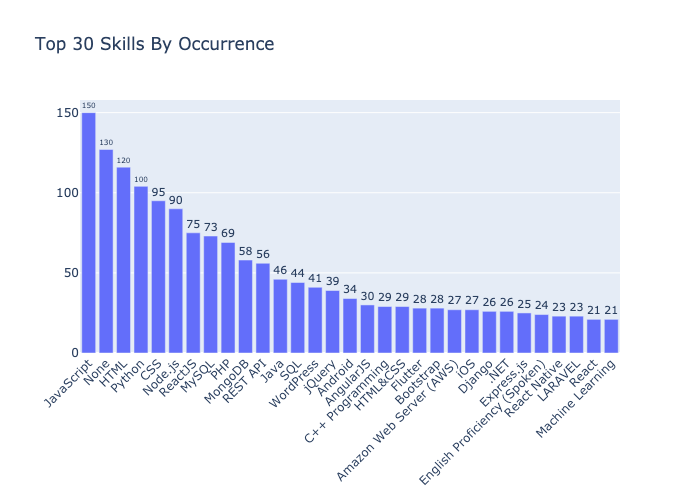

In [8]:
plot_bar_chart(skills_count_series[:31], "Top 30 Skills By Occurrence")

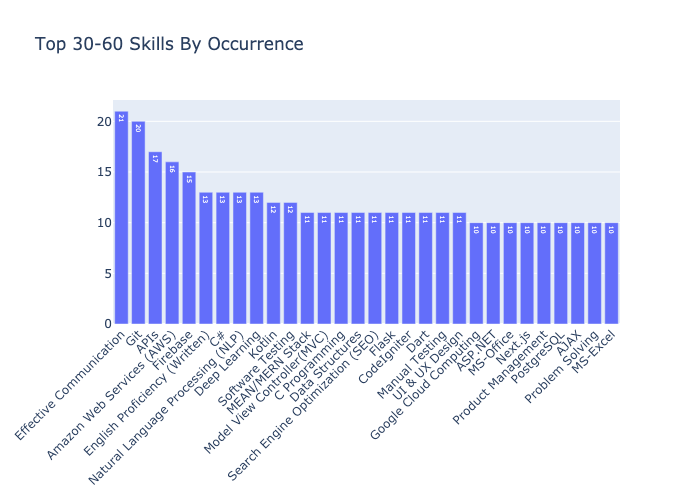

In [9]:
plot_bar_chart(skills_count_series[31:61], "Top 30-60 Skills By Occurrence", 'inside')

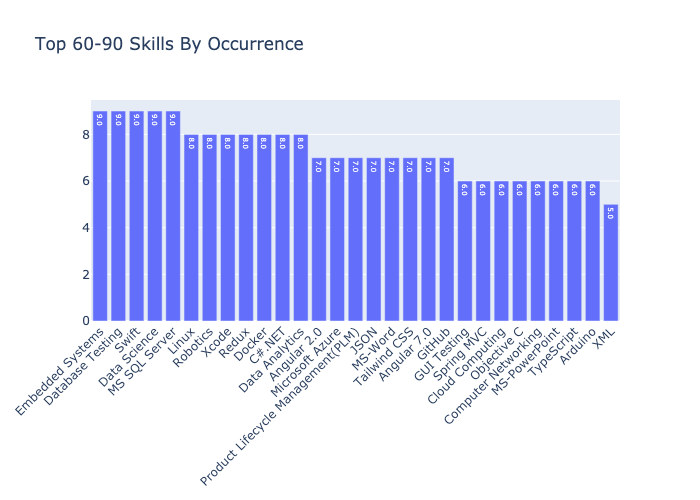

In [10]:
plot_bar_chart(skills_count_series[61:90], "Top 60-90 Skills By Occurrence", 'inside')

In [11]:
data_type_series = df.skills.apply(type)
print(data_type_series.value_counts())



skills
<class 'str'>    573
Name: count, dtype: int64


In [12]:
df.number_of_openings

0       NaN
1       1.0
2       NaN
3       3.0
4       2.0
       ... 
568     2.0
569     2.0
570     1.0
571     3.0
572    19.0
Name: number_of_openings, Length: 573, dtype: float64

In [13]:
df.skills

0                                                   None
1                                          Autodesk Maya
2                                                   None
3      CSS\nHTML\nJavaScript\nNode.js\nPython\nWordPress
4      Data Analytics\nData Science\nDeep Learning\nM...
                             ...                        
568                     Flutter\nMongoDB\nMySQL\nNode.js
569                             JavaScript\nOdoo\nPython
570    Algorithms\nAngularJS\nC Programming\nData Str...
571    Django\nFlask\nPython\nRobotic Process Automat...
572          JavaScript\nMySQL\nNode.js\nPython\nReactJS
Name: skills, Length: 573, dtype: object

In [14]:
float_values = df[df['skills'].apply(lambda x: isinstance(x, float))]['skills']
float_values

Series([], Name: skills, dtype: object)

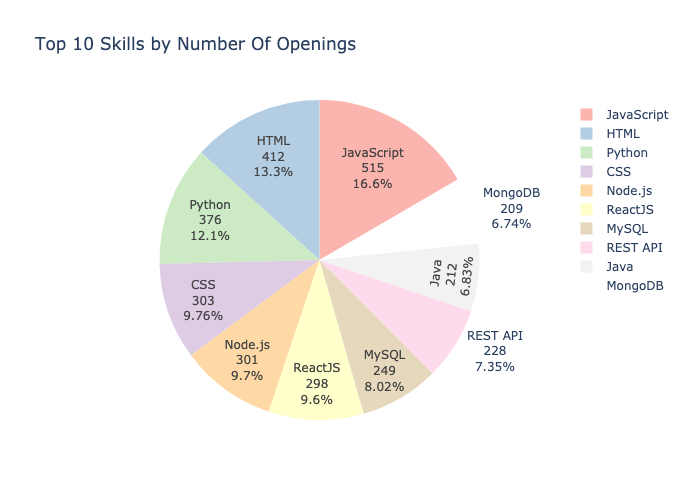

In [15]:
skills_openings_dict = {}
def compute_skills_openings(row): 
    openings_str = row['number_of_openings']
    if np.isnan(openings_str):
        return openings_str
    openings = openings_str
    skills_str = row['skills']
    split = skills_str.split('\n')
    for s in split:
        skills_openings_dict[s] = skills_openings_dict.get(s, 0) + openings


df.agg(compute_skills_openings,axis=1)
skills_openings_series = pd.Series(skills_openings_dict).sort_values(ascending=False)

plot_series_pie_chart(skills_openings_series[:10], "Top 10 Skills by Number Of Openings")

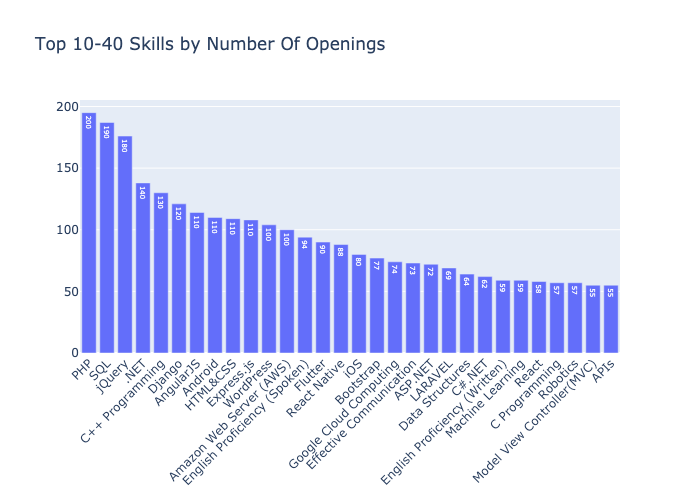

In [16]:
plot_bar_chart(skills_openings_series[10:40], "Top 10-40 Skills by Number Of Openings", 'inside')

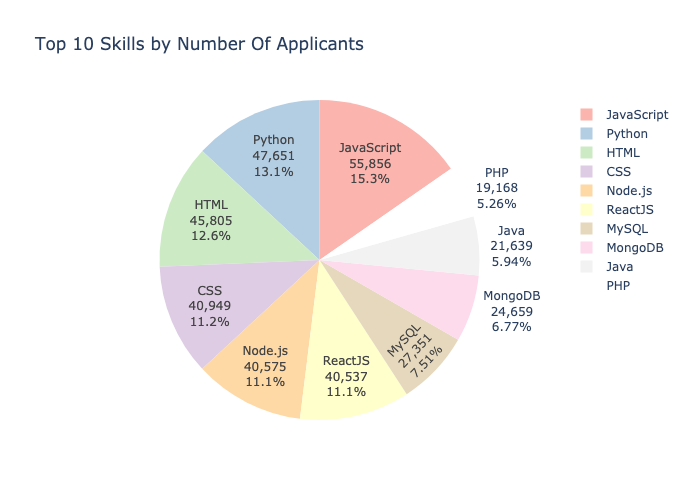

In [17]:
skills_applicants_dict = {}
def compute_skills_openings(row):
    applicants = row['applicants']
    skills_str = row['skills']
    split = skills_str.split('\n')
    for s in split:
        skills_applicants_dict[s] = skills_applicants_dict.get(s, 0) + applicants


df.agg(compute_skills_openings,axis=1)
skills_applicants_series = pd.Series(skills_applicants_dict).sort_values(ascending=False)
plot_series_pie_chart(skills_applicants_series[:10], "Top 10 Skills by Number Of Applicants")

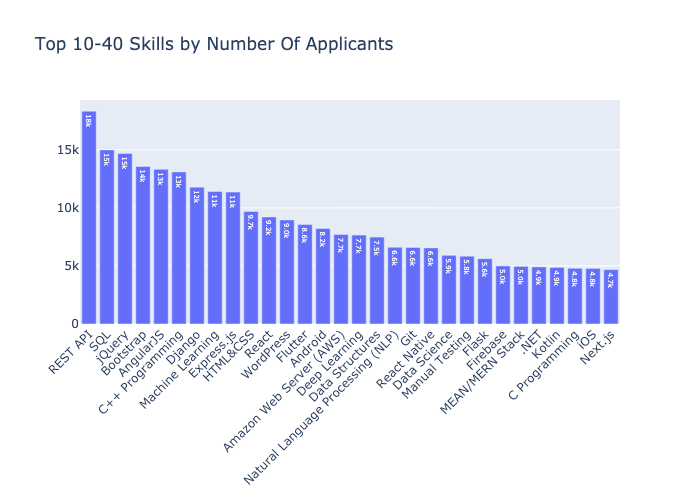

In [18]:
plot_bar_chart(skills_applicants_series[10:40], "Top 10-40 Skills by Number Of Applicants", 'inside')


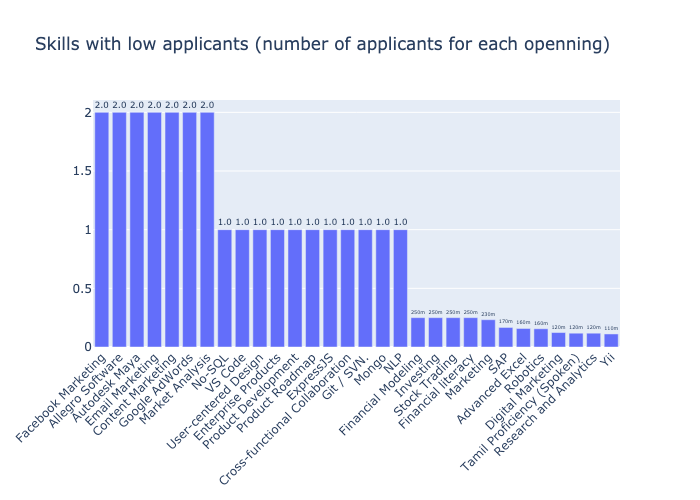

In [19]:
# Number of openings available per applicant
skills_o2a_dict = {}

# number of applicants for unit opening
skills_a2o_dict = {}

for skill in skills_applicants_series.index:
    if skill =='None':
        continue
    
    a = skills_applicants_dict[skill]
    o = skills_openings_dict[skill]
    skills_a2o_dict[skill] = a/o
    if(a == 0):
        skills_o2a_dict[skill] = o
    else:
        skills_o2a_dict[skill] = o/a

skills_o2a_series = pd.Series(skills_o2a_dict)
skills_a2o_series = pd.Series(skills_a2o_dict)


plot_bar_chart(skills_o2a_series.sort_values(ascending=False)[:30], "Skills with low applicants (number of applicants for each openning)")

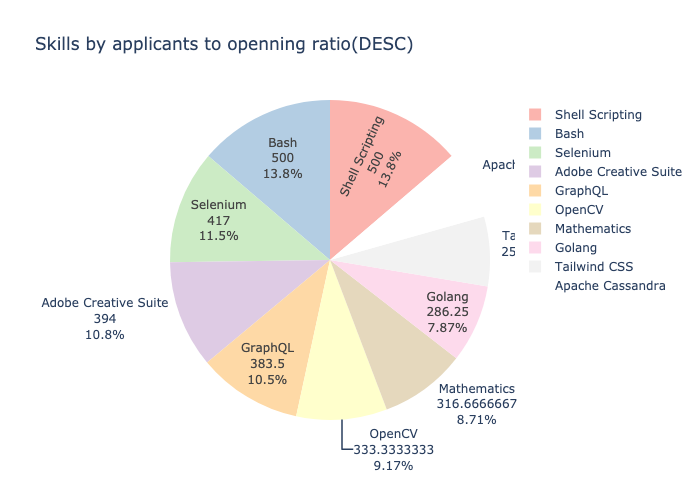

In [20]:
plot_series_pie_chart(skills_a2o_series.sort_values(ascending=False)[:30], "Skills by applicants to openning ratio(DESC)")


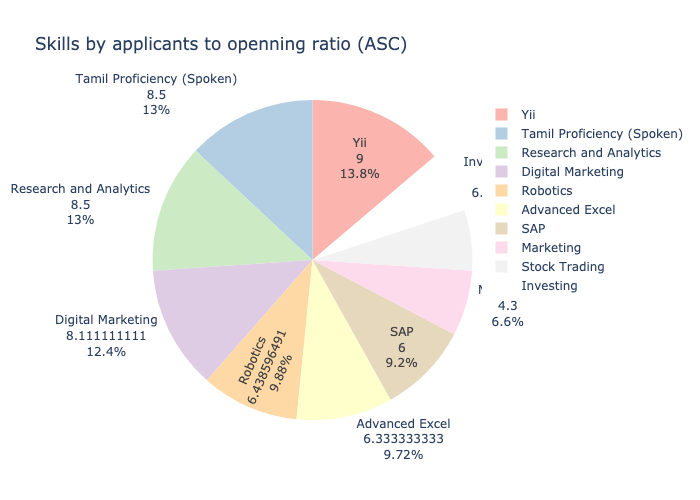

In [21]:
plot_series_pie_chart(skills_a2o_series.sort_values(ascending=True)[:30], "Skills by applicants to openning ratio (ASC)")


,skill,openings,applicants,oa_ratio,ao_ratio
0,iOS,80.0,4786,0.016715,59.825000
1,Android,110.0,8218,0.013385,74.709091
2,Kotlin,38.0,4875,0.007795,128.289474
3,JavaScript,515.0,55856,0.009220,108.458252
4,Flutter,90.0,8564,0.010509,95.155556
5,Amazon Web Services (AWS),49.0,3880,0.012629,79.183673
6,Python,376.0,47651,0.007891,126.731383
7,Deep Learning,43.0,7653,0.005619,177.976744
8,Machine Learning,59.0,11411,0.005170,193.406780
9,MySQL,249.0,27351,0.009104,109.843373


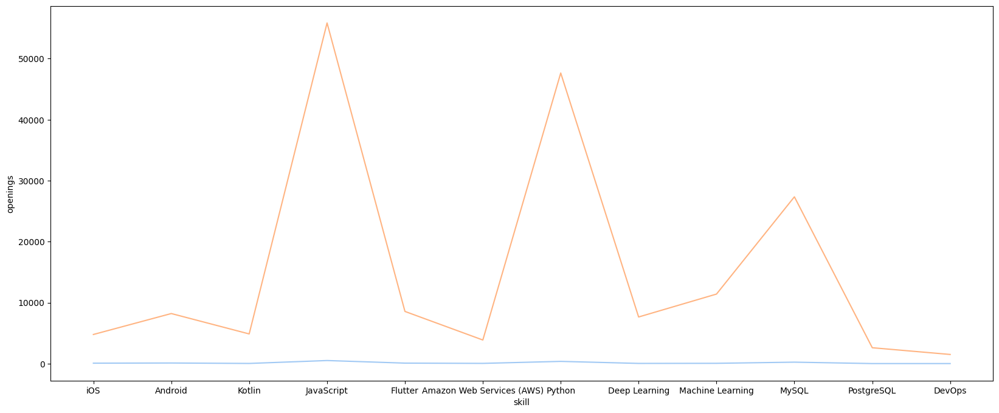

In [22]:
SELECT_SKILLS = ['iOS', 'Android', "Kotlin","JavaScript", 'Flutter', 'Amazon Web Services (AWS)',
'Python','Deep Learning', 'Machine Learning',
'MySQL', 'PostgreSQL', 'DevOps']

skills_oa_dict = []

for skill in SELECT_SKILLS:
    d = {}
    d['skill'] = skill
    d['openings'] = skills_openings_dict[skill]
    d['applicants'] = skills_applicants_dict[skill]
    d['oa_ratio'] = skills_o2a_dict[skill]
    d['ao_ratio'] = skills_a2o_dict[skill]
    skills_oa_dict.append(d)
selected_skills_oa_df = pd.DataFrame(skills_oa_dict)
plt.figure(figsize=(20,8))
ax = sns.lineplot(x=selected_skills_oa_df.skill, y=selected_skills_oa_df.openings)
sns.lineplot(x=selected_skills_oa_df.skill, y=selected_skills_oa_df.applicants, ax=ax)
selected_skills_oa_df

In [23]:
domain_with_skills = {}
def compute_skills_in_domains(series):
    domain = series['domain_profile']
    skills = series['skills']
    if(skills != None):
        skills = skills.split('\n')

        domain_skills = domain_with_skills.get(domain, {})
        for skill in skills:
            domain_skills[skill] = domain_skills.get(skill, 0) + 1
        
        domain_with_skills[domain] = domain_skills

df.agg(compute_skills_in_domains, axis=1)
domain_skills_df = pd.DataFrame(domain_with_skills)
domain_skills_df

,Web Developer,3d Environment Artist,PHP Developer,WordPress Developer,Junior Machine Learning Specialist,Node.js Developer,.NET Developer,Junior Python Developer,Programmer (Teacher),Apprentice - Data Exchange And Interoperability,...,Android Developer,Product Analyst,Digital Marketing Manager,Game Developer,System Administrator,Angular Developer,QA Engineer,AI/ML Chatbot Developer,Odoo Developer,Associate Python Developer
None,10.0,NaN,30.0,12.0,NaN,2.0,1.0,1.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HTML,10.0,NaN,11.0,7.0,NaN,1.0,6.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HTML&CSS,5.0,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
JavaScript,12.0,NaN,9.0,7.0,NaN,2.0,7.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,1.0,NaN
jQuery,7.0,NaN,6.0,NaN,NaN,NaN,2.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Unity 3D,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN
Wireframing,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Unity Engine,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN
Unreal Engine,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN


In [24]:
df.domain_profile.value_counts()[:20]

domain_profile
Full Stack Developer            55
PHP Developer                   44
Web Developer                   29
Python Developer                26
WordPress Developer             23
Front End Developer             22
Software Developer              17
Java Developer                  16
Android App Developer           14
Backend Developer               12
.NET Developer                  11
Associate Software Developer    10
Junior Software Developer        9
Product Manager                  9
Senior PHP Developer             8
iOS App Developer                6
Junior Full Stack Developer      6
Node.js Developer                5
Software Tester                  5
ASP.NET Developer                5
Name: count, dtype: int64

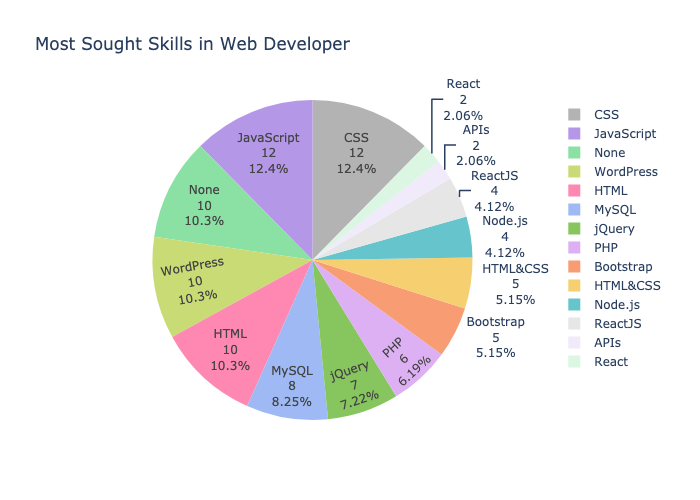

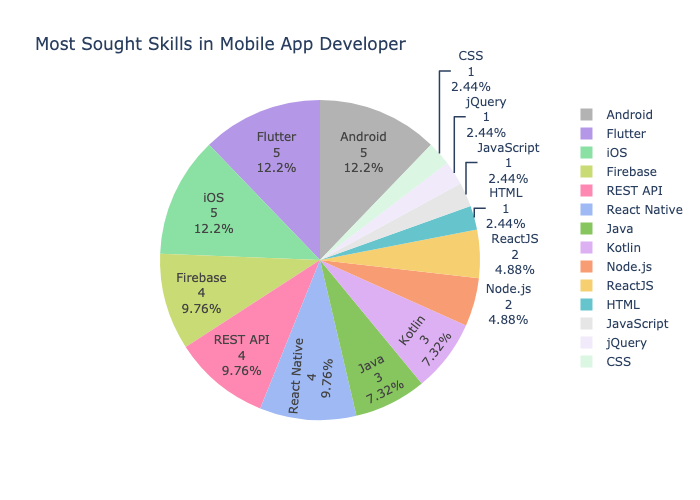

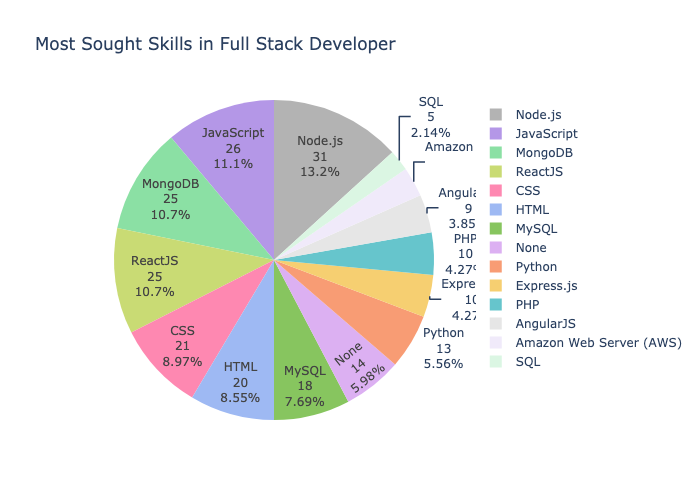

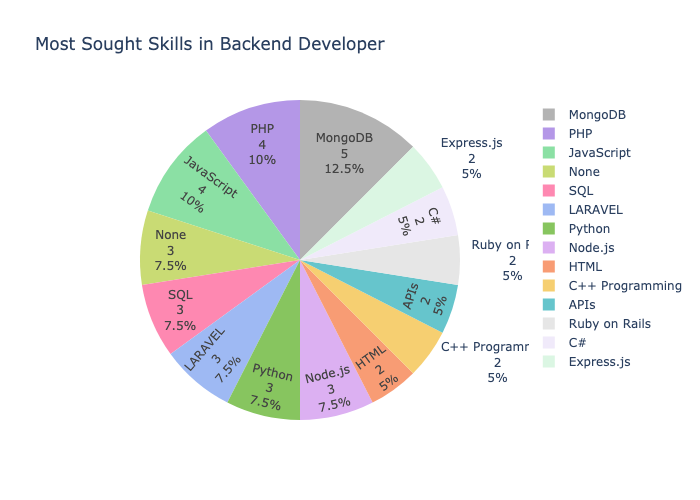

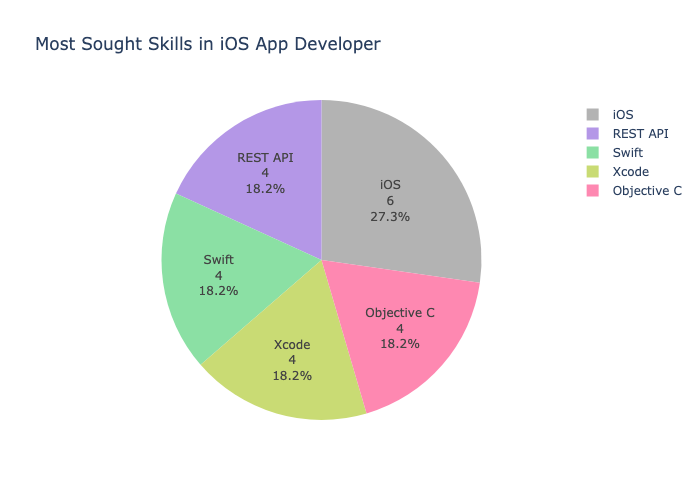

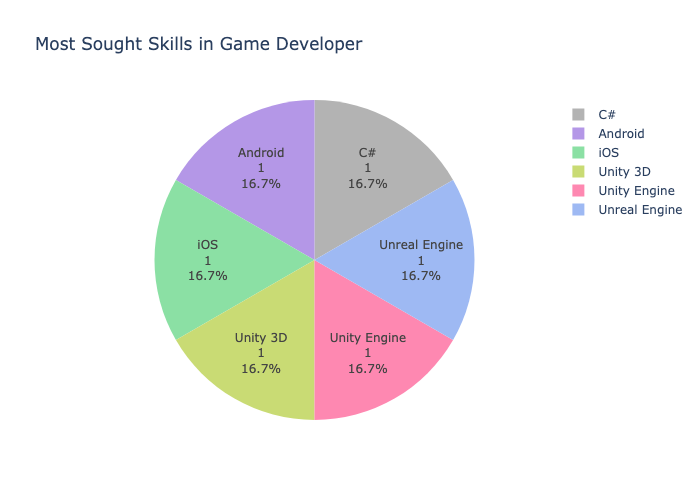

In [25]:
selected_domains = ['Web Developer', 'Mobile App Developer', 'Full Stack Developer',
'Backend Developer', 'iOS App Developer', 'Game Developer']

for domain in selected_domains:
    stack = domain_skills_df[domain][pd.notna(domain_skills_df[domain])].sort_values(ascending=False)
    plot_series_pie_chart(stack, f"Most Sought Skills in {domain}", max=14, color_seq=px.colors.qualitative.Pastel_r)

 ## Location Analysis



In [26]:
all_location_series = df.location.value_counts()/df.location.value_counts().values.sum()
all_locations = all_location_series.sort_values(ascending=False).to_dict()
display("Top 5 Locations")
display(df.location.value_counts()[:5])

'Top 5 Locations'

location
Work from home    163
Bangalore          64
Delhi              43
Mumbai             38
Pune               22
Name: count, dtype: int64

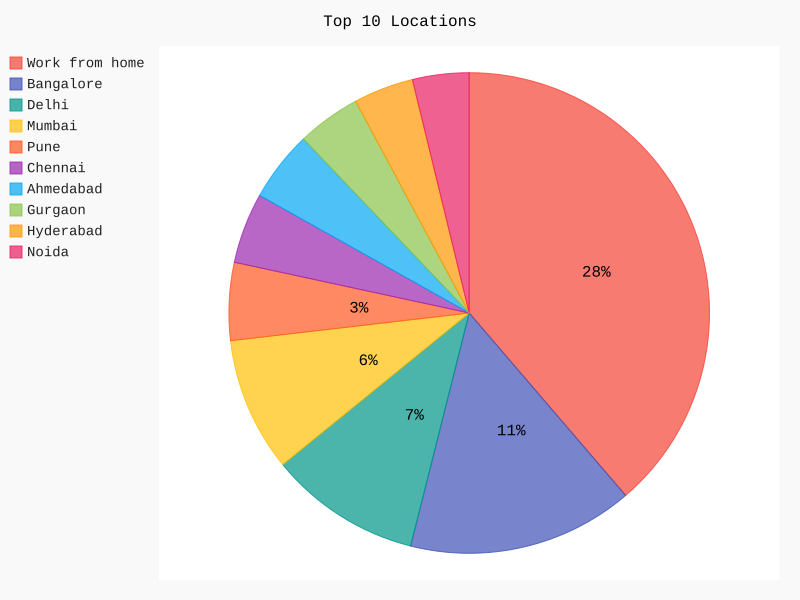

In [27]:
top_10_locations = list(all_locations.keys())[:10]
pie_chart = pygal.Pie(print_values=True)
pie_chart.value_formatter = lambda x: f"{math.floor(x*100)}%"
pie_chart.title = 'Top 10 Locations'
for location in top_10_locations:
    pie_chart.add(location, all_locations[location])

# pie_chart.render()
# pie_chart
display(SVG(pie_chart.render(disable_xml_declaration=True)))

In [28]:
location_group_by = df.groupby(by='location')
top_10_applicant_by_location = location_group_by.applicants.sum().sort_values(ascending=False)[:10]

label = top_10_applicant_by_location.index.tolist()
value = top_10_applicant_by_location.values.tolist()

fig = go.Figure(
    data=[go.Bar(
        x = label, 
        y = value, 
        text= value)],
    layout_title_text="Top 10 Location By Number Of Applicants",  
)
fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.update_layout(xaxis_tickangle=-45)
fig.show(renderer="notebook")

In [29]:
numeric_column = pd.to_numeric(df['number_of_openings'], errors='coerce')


In [30]:
location_with_opennings = location_group_by.number_of_openings.sum().sort_values(ascending=False)[:10]
# sns.barplot(y=location_with_opennings.index[:20], x=location_with_opennings.values[:20])

fig = go.Figure(
    data=[go.Bar(
        x = location_with_opennings.index.tolist(), 
        y = location_with_opennings.values.tolist(), 
        text= location_with_opennings.values.tolist())],
    layout_title_text="Top 10 Locations By Number Of Opennings",  
)
fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.update_layout(xaxis_tickangle=-45)
fig.show(renderer="notebook")

Work from home    218.099673
Mumbai            100.632432
Delhi             112.947009
Bangalore         195.961047
dtype: float64

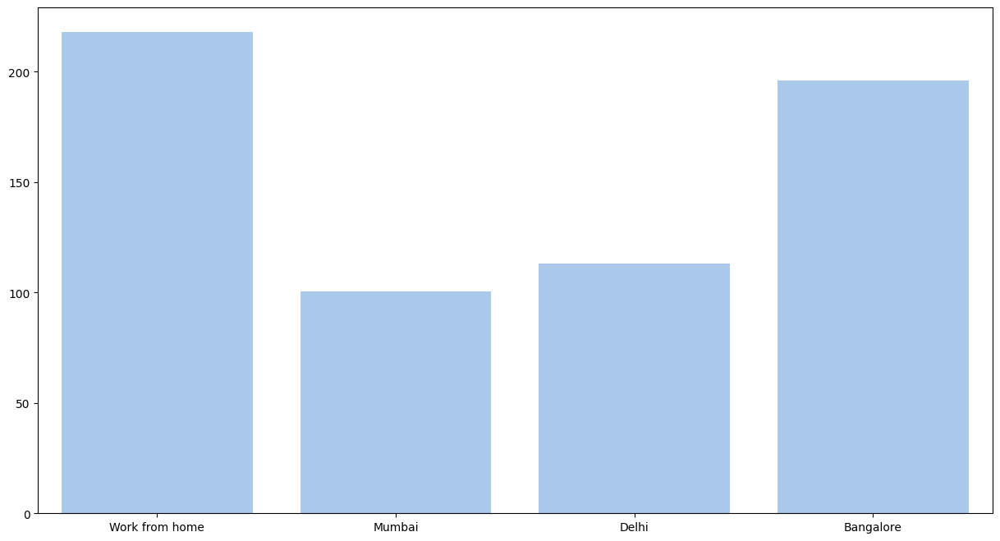

In [31]:
def compute_applicants_to_openings_ratio(series):
    return series.applicants/series.number_of_openings

# location_group_by.agg(compute_openning_to_applicants_ratio)
# df.applicants/df.number_of_openings
# df.apply(lambda row: print(row))

cols = {"Work from home": 0, "Mumbai":0, "Delhi":0, 'Bangalore':0}

for col in cols:
    cols[col] = location_group_by.apply(compute_applicants_to_openings_ratio,include_groups=False)[col].mean()

title = "Mean ratio of Number of applicants vs openning"
plt.figure(figsize=(15,8))
sns.barplot(x=list(cols.keys()), y=list(cols.values()))
display(pd.Series(cols))

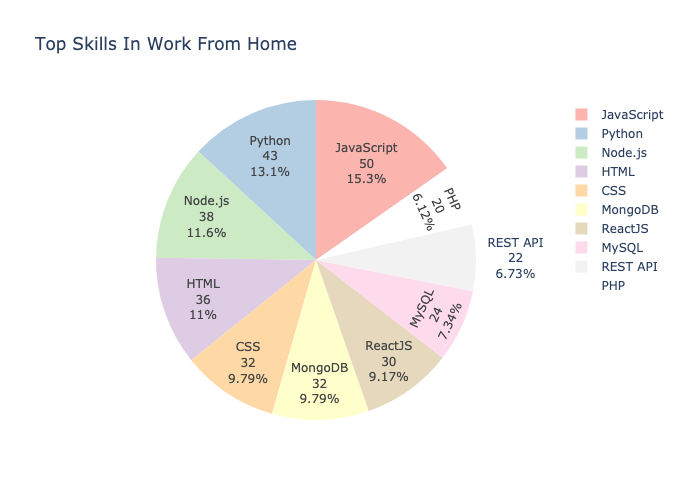

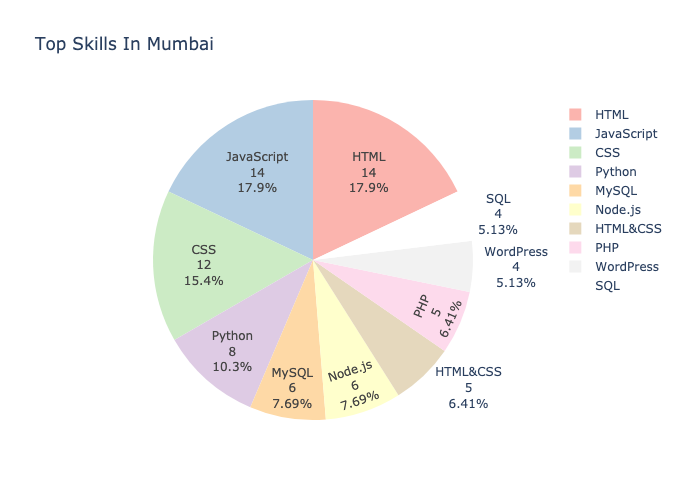

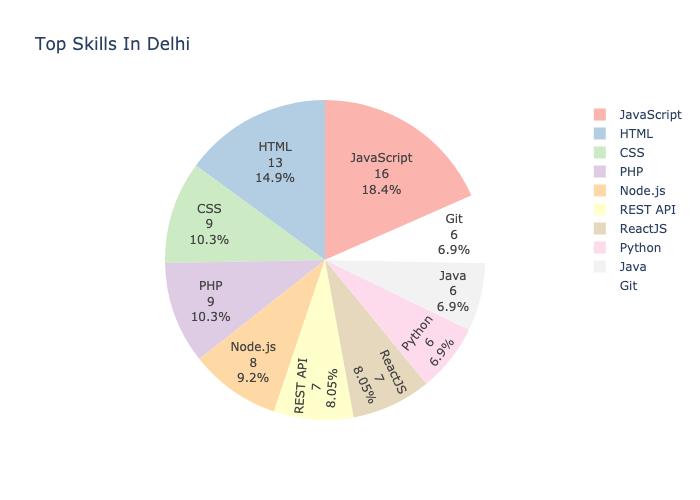

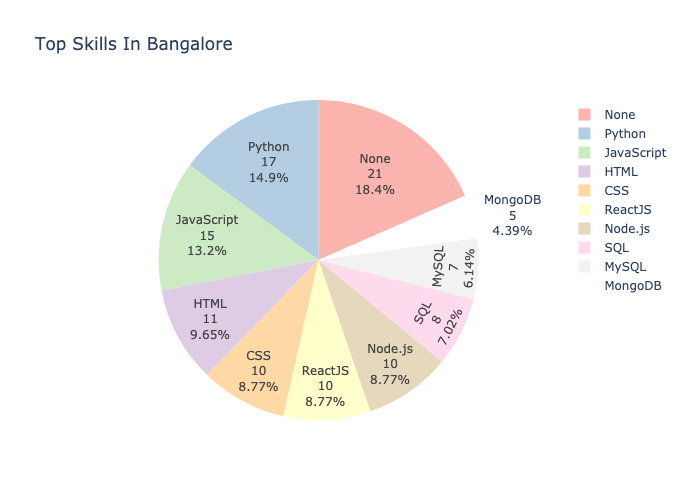

In [32]:
# location(top 5) vs most popular skill (top 5 skills)
def skills_counter(series):
    skills_super_set = {}
    def counter(input_string):
        if(type(input_string) == str):
            for i in input_string.split('\n'):
                skills_super_set[i] = skills_super_set.get(i, 0) + 1
        return None
    series.apply(counter)
    return skills_super_set

location_gb_ag_skills = location_group_by.skills.agg(skills_counter)

wfh_series = pd.Series(location_gb_ag_skills['Work from home'])
mumbai_series = pd.Series(location_gb_ag_skills['Mumbai'])
delhi_series = pd.Series(location_gb_ag_skills['Delhi'])
bangalore_series = pd.Series(location_gb_ag_skills['Bangalore'])

plot_series_pie_chart(wfh_series, "Top Skills In Work From Home")
plot_series_pie_chart(mumbai_series, "Top Skills In Mumbai")
plot_series_pie_chart(delhi_series, "Top Skills In Delhi")
plot_series_pie_chart(bangalore_series, "Top Skills In Bangalore")

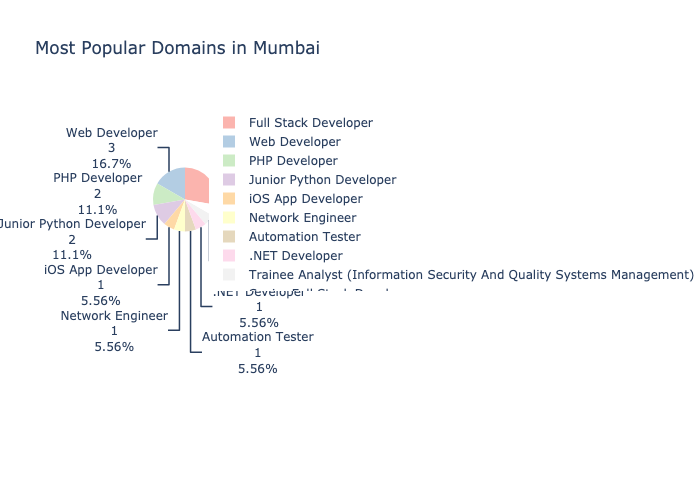

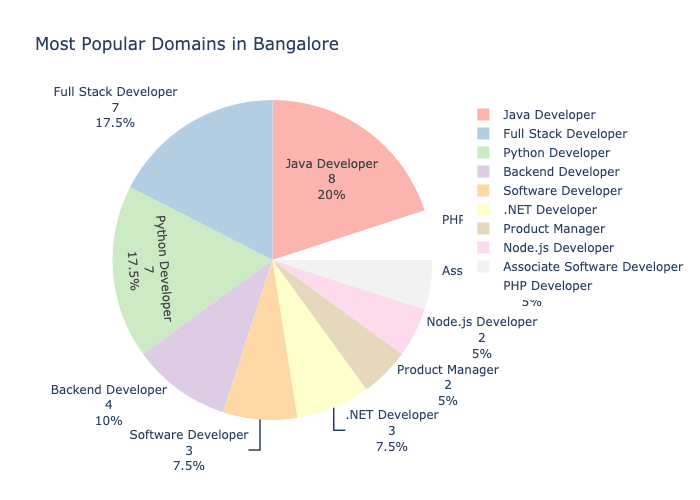

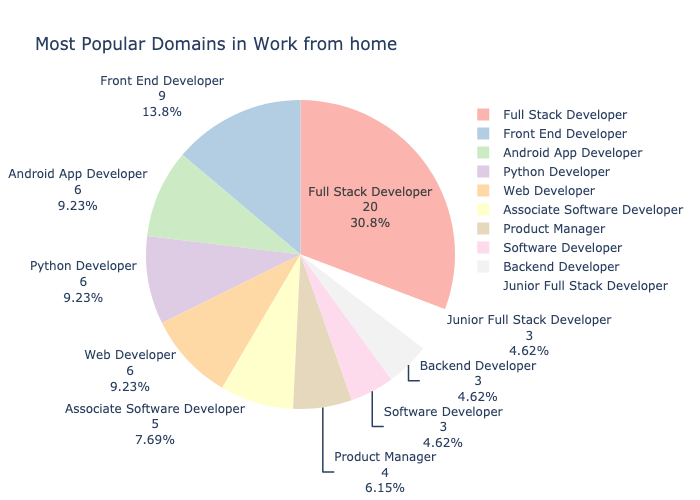

In [33]:
# location vs domain_profile

def location_per_domain(series):
    return series.value_counts().to_dict()

location_domain_groupby = location_group_by.domain_profile.agg(location_per_domain)

cols = ['Mumbai', 'Bangalore', 'Work from home']

for col in cols:
    series = pd.Series(location_domain_groupby[col])
    plot_series_pie_chart(series, f"Most Popular Domains in {col}")

In [34]:
all_perks = {}

def extract_perks(series):
    if(type(series) == str):
        perks = series.split("\n")
        for perk in perks:
            perk = perk.strip()
            all_perks[perk] = all_perks.get(perk, 0) + 1

_ = df.perks.apply(extract_perks)


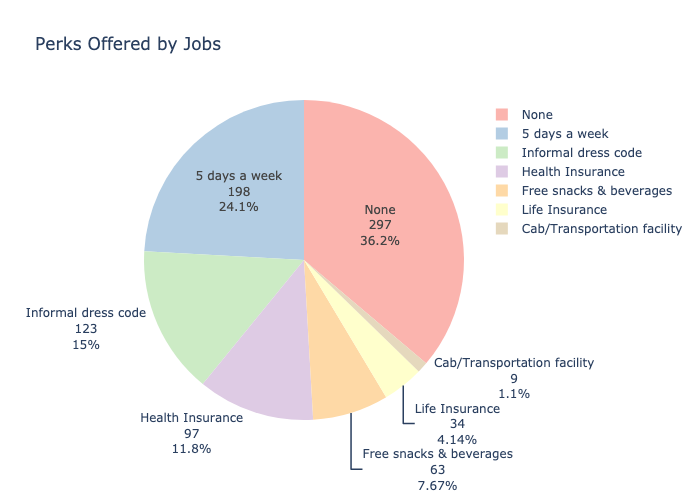

In [35]:
perks_series = pd.Series(data=list(all_perks.values()), index=list(all_perks.keys()))

plot_series_pie_chart(perks_series, 'Perks Offered by Jobs')

## Salary


### Most Popular Packages 


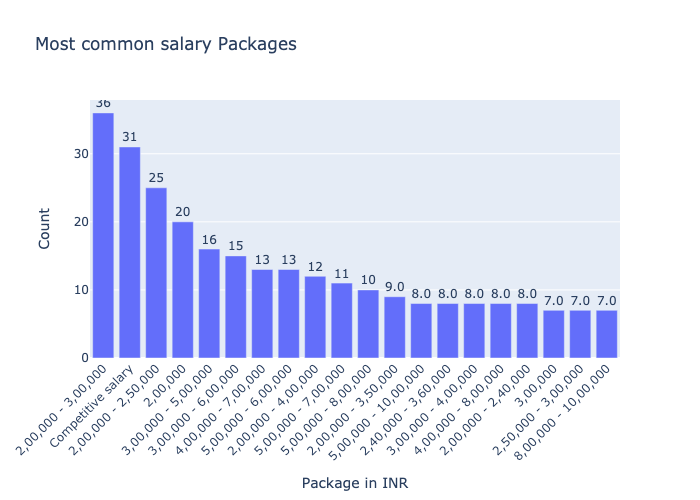

In [36]:
plot_bar_chart(df.salary.value_counts()[:20], "Most common salary Packages", xaxis_label='Package in INR', yaxis_label='Count')

In [37]:
salary_sorted_df = df.sort_values(by='max_salary', ascending=False)

<Axes: xlabel='max_salary', ylabel='Count'>

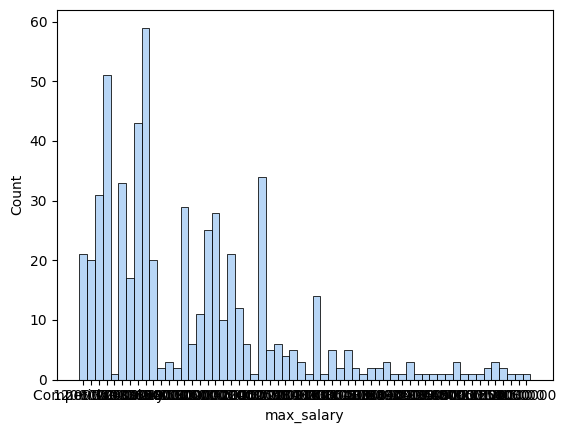

In [38]:
sns.histplot(df.max_salary)


### Location

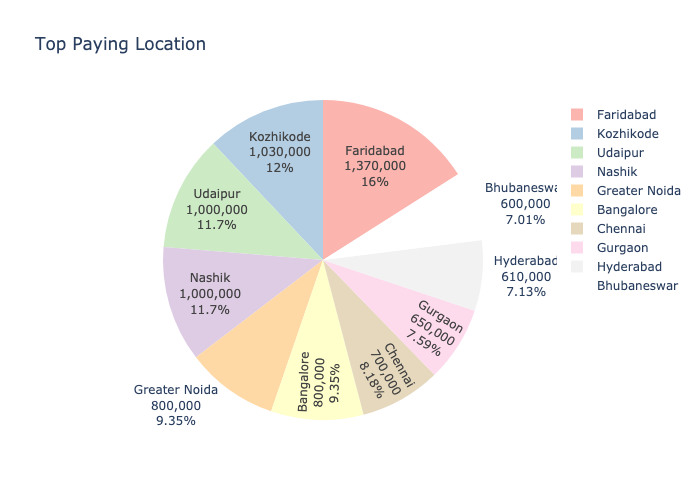

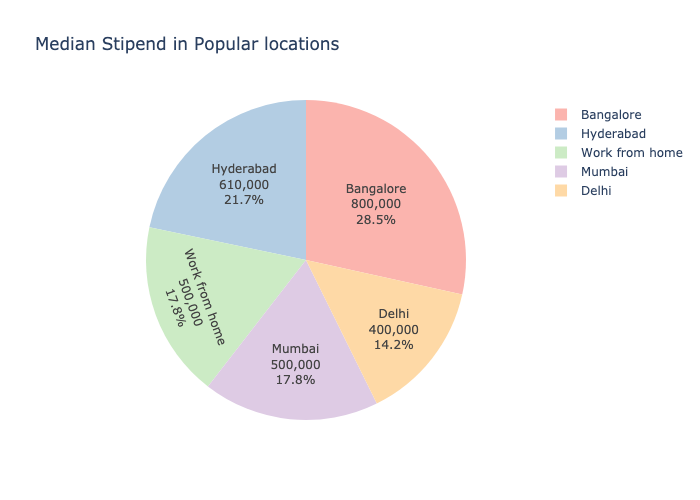

In [39]:
# location

# Convert 'max_salary' to numeric, coercing any errors (e.g., 'Unknown', other non-numeric strings) to NaN
df['max_salary'] = pd.to_numeric(df['max_salary'], errors='coerce')

# Now that 'max_salary' is numeric, calculate the median of max_salary for each location
top_paying_locations = df.groupby('location')['max_salary'].median().sort_values(ascending=False)

selected_locations = ['Work from home', 'Mumbai', 'Bangalore', 'Delhi', 'Hyderabad']
median_salary = [top_paying_locations[selected_locations[i]] for i in range(len(selected_locations))]

plot_series_pie_chart(top_paying_locations, "Top Paying Location")
plot_series_pie_chart(pd.Series(median_salary, index=selected_locations), "Median Stipend in Popular locations")


### Domain

Text(0.5, 1.0, 'Top Paying Domains')

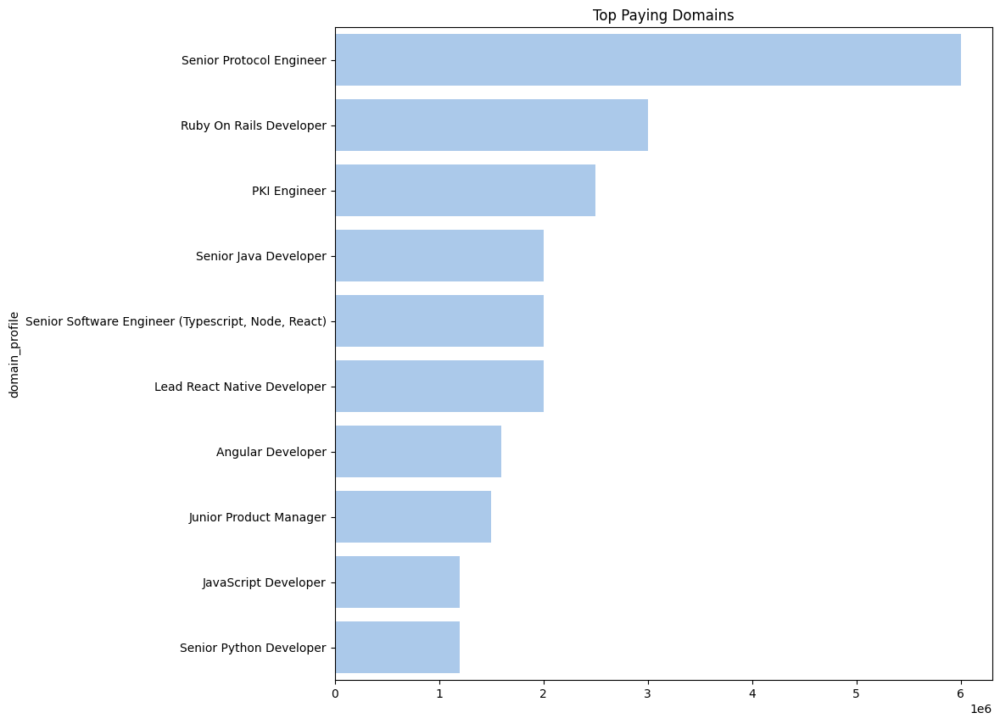

In [40]:
domain_salary = df.groupby('domain_profile').max_salary.median().sort_values(ascending=False)
number_of_internships = df.domain_profile.value_counts().loc[domain_salary.index]

plt.figure(figsize=(10,10))
ax = sns.barplot(y=domain_salary[:10].index, x=domain_salary[:10].values)
ax.set_title("Top Paying Domains")

### Company Name

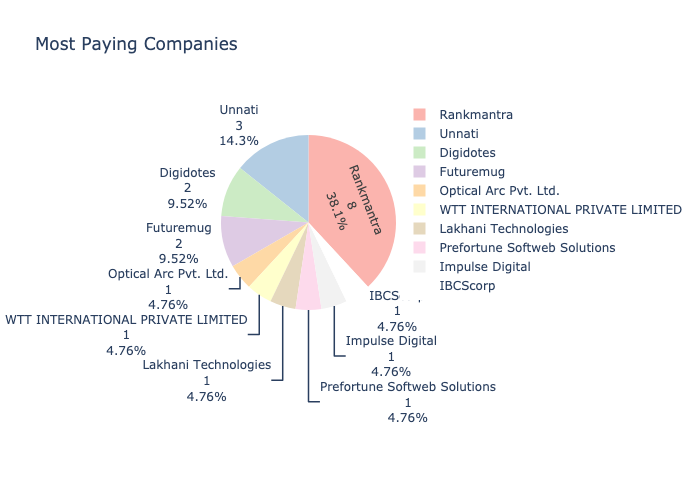

In [41]:
company_names = salary_sorted_df[:30].company_name.value_counts()
plot_series_pie_chart(company_names, "Most Paying Companies")

### Skills

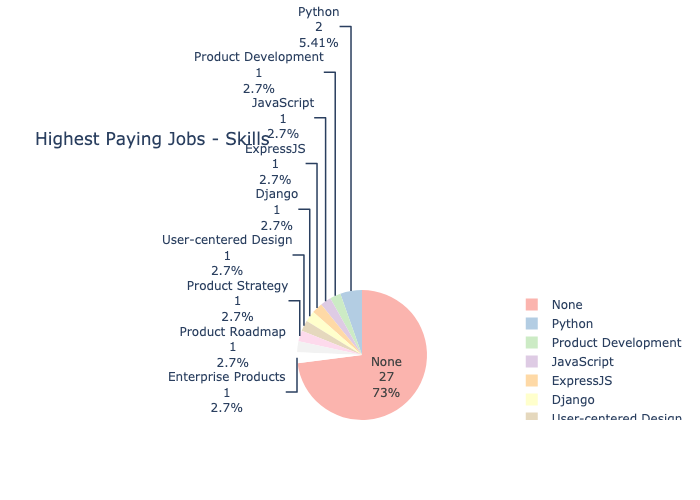

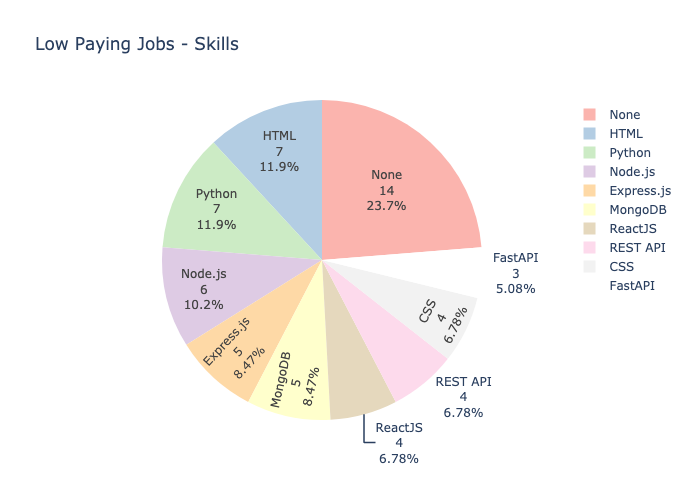

In [42]:
def get_series_from_dict(d):
    return pd.Series(data=list(d.values()), index=list(d.keys()))

high_paying_skillset = get_series_from_dict(agg_skillset(salary_sorted_df[:30].skills))
low_paying_skillset = get_series_from_dict(agg_skillset(salary_sorted_df[-30:-1].skills))

plot_series_pie_chart(high_paying_skillset, 'Highest Paying Jobs - Skills')
plot_series_pie_chart(low_paying_skillset, 'Low Paying Jobs - Skills')

### Analysing skills from popular companies 


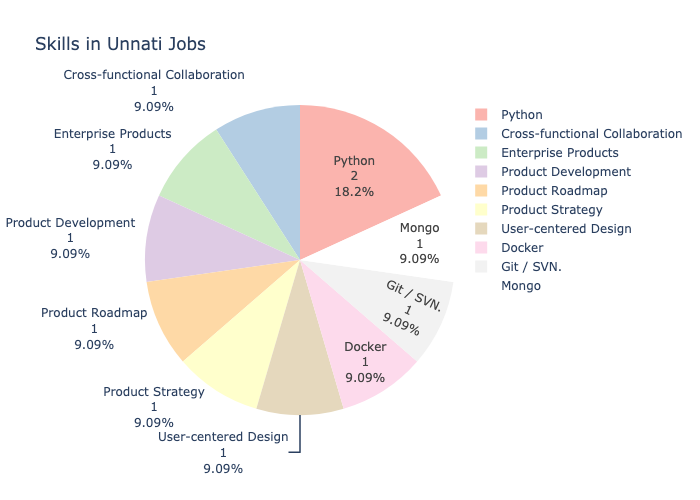

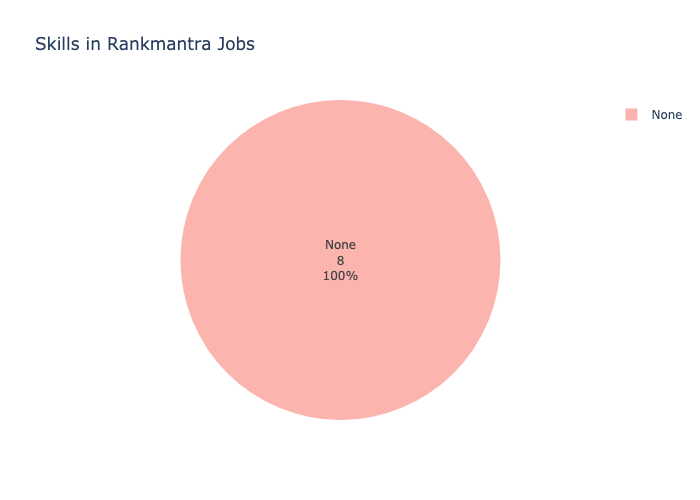

In [43]:
def get_jobs_by_company(name):
    return df[df.company_name.str.contains(name)]

unnati_df = get_jobs_by_company('Unnati')
rankmantra_df = get_jobs_by_company('Rankmantra')

unnati_df_skill_set = agg_skillset(unnati_df.skills)
rankmantra_df_set = agg_skillset(rankmantra_df.skills)

plot_series_pie_chart(get_series_from_dict(unnati_df_skill_set), "Skills in Unnati Jobs")
plot_series_pie_chart(get_series_from_dict(rankmantra_df_set), "Skills in Rankmantra Jobs")

In [44]:
print(f'Median Salary in Unnati {unnati_df.max_salary.median()}')
print(f'Number of applicants for one opening = {unnati_df.applicants.sum()/unnati_df.number_of_openings.sum()}')

Median Salary in Unnati nan
Number of applicants for one opening = 0.0


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning:

Mean of empty slice



### Domain Profile

In [45]:
########### DOMAIN #############
# top 5 domains pie chart
label = df['domain_profile'].value_counts()[:5].index.tolist()
value = df['domain_profile'].value_counts()[:5].values.tolist()
'''trace = go.Pie(labels=label, 
                values=value, 
                marker=dict(colors=['red']), 
                # Seting values to 
                hoverinfo="value"
              )
data = [trace]
layout = go.Layout(title="Top 5 Domains")
fig = go.Figure(data = data,layout = layout)
'''

fig = px.pie(
    names = label,
    values = value,
    title="Top 5 Domains By Number Of Jobs",
    color_discrete_sequence=px.colors.qualitative.Pastel2
    )
fig['data'][0].update({'textinfo' : 'label+text+value+percent'})
fig.show(renderer="notebook")

In [46]:
# top 20 domains bar graph
label = df['domain_profile'].value_counts()[:20].index.tolist()
value = df['domain_profile'].value_counts()[:20].values.tolist()

fig = go.Figure(
    data=[go.Bar(y = value, x = label, text= value)],
    layout_title_text="Top 20 Domains By Number Of Jobs",  
    )
fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.update_layout(xaxis_tickangle=-45)
fig.show(renderer="notebook")

In [47]:
df['avg_salary'] = pd.to_numeric(df['avg_salary'], errors='coerce')

In [48]:
# top 10 paid avg by domain
#df[['company_name','domain_profile','mean_stipend']].sort_values(by=['mean_stipend'], ascending=False)[:10]

davg = df[['domain_profile','avg_salary']].sort_values(by=['avg_salary'], ascending=False)[0:10].reset_index()
fig = go.Figure(
    data=[go.Bar(y = davg.avg_salary, x = davg.domain_profile, text= davg.avg_salary)],
    layout_title_text="Top 10 Paid Domains based on Average Salary",  
)
fig.update_traces(texttemplate='%{text:.2s}', textposition='inside')
fig.update_layout(xaxis_tickangle=-45)
fig.show(renderer="notebook")

In [49]:
#top 10 paid max by domain
dmax = df[['domain_profile','max_salary']].sort_values(by=['max_salary'], ascending=False)[:10].reset_index()
fig = go.Figure(
    data=[go.Bar(y = dmax.max_salary, x = dmax.domain_profile, text= dmax.max_salary)],
    layout_title_text="Top 10 Paid Domains based on Maximum Salary",  
)
fig.update_traces(texttemplate='%{text:.2s}', textposition='inside')
fig.update_layout(xaxis_tickangle=-45)
fig.show(renderer="notebook")
